## Business Data Science Final Project - TEAM LAMIA:

### Richa Bathija - Barrett Poth - Thomas Stamatopoulos - Xinshuang Zhao

## 01. Introduction

An existential problem for any major website today is how to handle toxic and divisive content. Quora wants to tackle this problem head-on to keep their platform a place where users can feel safe sharing their knowledge with the world.

Quora is a platform that empowers people to learn from each other. On Quora, people can ask questions and connect with others who contribute unique insights and quality answers. A key challenge is to weed out insincere questions -- those founded upon false premises, or that intend to make a statement rather than look for helpful answers.

In this project we developed a model that identifies and flags insincere questions. While Quora has already employed both machine learning and manual review to address this problem through this project we plan to develop more scalable methods to detect toxic and misleading content, as Quora tries to implement its policy of "Be Nice, Be Respectful" to be a place for sharing and growing the world's knowledge.

![Jupyter](https://upload.wikimedia.org/wikipedia/commons/9/91/Quora_logo_2015.svg)

## 02. Dataset

The idea of the project was initiated due to a relevant Kaggle competition set by the company, using the given datasets as a reliable and unbaised source of data. Collecting the data from the relevant competition we had a labeled dataset (sincere: target=0, insincere: taget=1) of 1,306,122 questions that we used to train our model, as well as 56,370 questions that that did not have labels and were used to test our model's prediction accuracy.

In [1]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 50)

In [2]:
data_train = pd.read_csv('train.csv')
data_train.shape

(1306122, 3)

In [3]:
data_train.head()

,qid,question_text,target
0,00002165364db923c7e6,How did Quebec nationalists see their province...,0
1,000032939017120e6e44,"Do you have an adopted dog, how would you enco...",0
2,0000412ca6e4628ce2cf,Why does velocity affect time? Does velocity a...,0
3,000042bf85aa498cd78e,How did Otto von Guericke used the Magdeburg h...,0
4,0000455dfa3e01eae3af,Can I convert montra helicon D to a mountain b...,0


In [4]:
data_test = pd.read_csv('test.csv')
data_test.shape

(56370, 2)

In [5]:
data_test.head()

,qid,question_text
0,00014894849d00ba98a9,My voice range is A2-C5. My chest voice goes u...
1,000156468431f09b3cae,How much does a tutor earn in Bangalore?
2,000227734433360e1aae,What are the best made pocket knives under $20...
3,0005e06fbe3045bd2a92,Why would they add a hypothetical scenario tha...
4,00068a0f7f41f50fc399,What is the dresscode for Techmahindra freshers?


## 03. Data Analysis-(1) Data Distribution

Irrespective of the context and sentiment behind the questions, we first took a look at some basic characteristics of the dataset, in order to identify flaws at an early stage as well as to get a better statistical grasp of it. Below are all the libraries and tools that were used for the analysis of our training data, kept together in one cell for houskeeping purposes.

In [6]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings 
import time
import gc

import bokeh.plotting as bp
from bokeh.models import HoverTool, BoxSelectTool
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure, show, output_notebook, reset_output
from bokeh.palettes import d3
import bokeh.models as bmo
from bokeh.io import save, output_file

import re
import string
import nltk
from nltk.tokenize import word_tokenize, sent_tokenize, TweetTokenizer
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer 

from collections import Counter
from nltk.util import ngrams
# from appos import * # import APPOS dictionary

from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.model_selection import GridSearchCV
from sklearn.manifold import TSNE

from wordcloud import WordCloud

np.random.seed(32)
color = sns.color_palette("Set2")
warnings.filterwarnings("ignore")
stop_words = set(stopwords.words("english"))
punctuations = string.punctuation
output_notebook()

%matplotlib inline

train = data_train

Loading BokehJS ...

**NULL VALUES**

In [7]:
train.isna().sum()

qid              0
question_text    0
target           0
dtype: int64

As a first step, we took a look at the training data identifying if there are any null values and it turns out that there were no null values, which is a good first indication of the quality of our dataset.

**DATA DISTRIBUTION & SKEWNESS**

Next we dug further into the data and checked how skewed it is in regards to the sincerety of the questions.

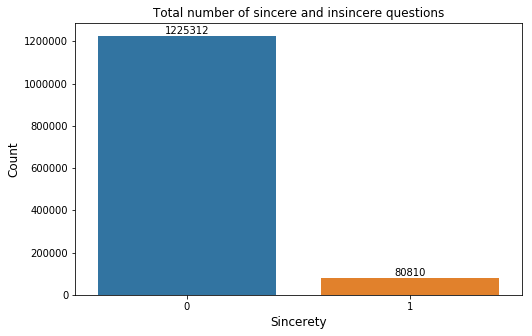

In [8]:
target_count = train["target"].value_counts()

plt.figure(figsize = (8, 5))
plt.xlabel("Sincerety", fontsize = 12)
plt.ylabel("Count", fontsize = 12)
plt.title("Total number of sincere and insincere questions", fontsize = 12)
ax = sns.barplot(target_count.index, target_count.values)
rects = ax.patches
labels = target_count.values
for rect, label in zip(rects, labels):
    ax.text(rect.get_x() + rect.get_width()/2, rect.get_height() + 5,
           label, ha = "center", va = "bottom")
plt.show()

In [9]:
# calculating percentage of sincere questions
senc_perc = train[train['target'] == 0]
inse_perc = train[train['target'] == 1]
print ('Percentage of sincere questions: ',round((len(senc_perc) / (len(senc_perc)+len(inse_perc)))*100,2))
print ('Percentage of insincere questions: ',6.19)

Percentage of sincere questions:  93.81
Percentage of insincere questions:  6.19


As expected our dataset was strongly skewed with 93.81% of the questions being sincere. Most people posting questions seem to have real questions that they want to get answer and have good intentions. For our analysis, this meant that we cannot use accuracy as our prediction metric, but rather use ROC score.

**QUESTION LENGTH DISTRIBUTION**

The length of the questions themselves is also an important aspect that could reveal a difference among sincere and insincere questions.

In [10]:
# creating new feature - question length
train["quest_len"] = train["question_text"].apply(lambda x: len(x.split()))

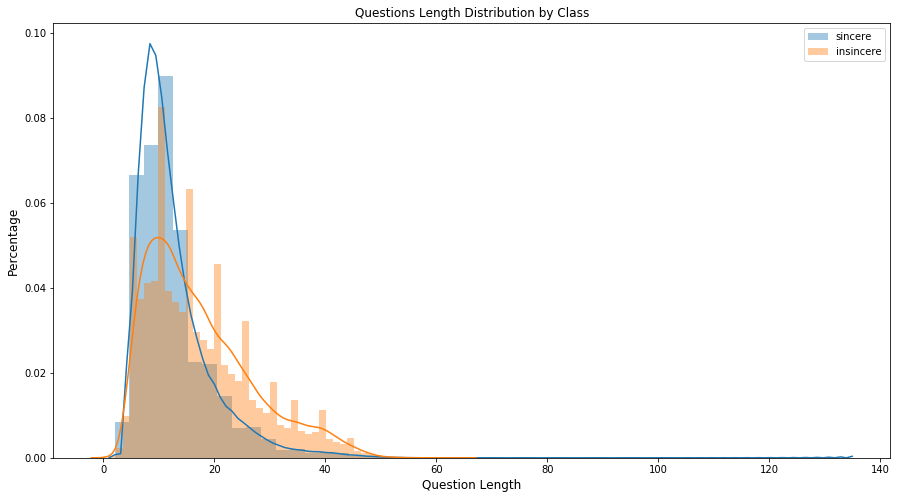

In [11]:
sincere = train[train["target"] == 0]
insincere = train[train["target"] == 1]

plt.figure(figsize = (15, 8))
sns.distplot(sincere["quest_len"], hist = True, label = "sincere")
sns.distplot(insincere["quest_len"], hist = True, label = "insincere")
plt.legend(fontsize = 10)
plt.title("Questions Length Distribution by Class", fontsize = 12)
plt.xlabel("Question Length", fontsize = 12)
plt.ylabel("Percentage", fontsize = 12)
plt.show()

Based on the above, and taking into account the high skewness of the data, it appears that insincere questions tend to be slightly longer while at any case most questions are between 5 to 20 words long indicating their simplicity and forwardness.

## 03. Data Analysis-(2) Insincere Questions Topic Modeling

The characterization of a question as sincere or insincere is rather vague, and it clearly depends on the policies of the platform (Quora). While their policies are implemented by trained professionals, given the minimum information provided and mostly summarized in a single phrase ("Be Nice, Be Respectful" ), we needed to further analyse our data in order to identify the actual context of insincere questions. To do that we implemented topic modeling taking into account the insincere questions of the dataset and identified the relevant underlying themes.

### DATA CLEANING

Given the already identified simplicity of the questions, before the implementation of the topic modeling, we standardized the questions' writting style and removed unecessary features. First we removed apostrophes while replacing them with the relevant complete texts. Then we implemented lemmatisation across the questions, replacing all words with their respective dictionary forms (lemmas) so that we could reduce the variety of the questions without losing any of the context or sentiment. Lastly, we disregarded english stop words reducing the size of our question further, since at this stage of the analysis we focused on single words and not phrases.

In [12]:
# https://drive.google.com/file/d/0B1yuv8YaUVlZZ1RzMFJmc1ZsQmM/view
# Aphost lookup dict
# no external data are allowed in this competition

APPO = {
"aren't" : "are not", "can't" : "cannot", "couldn't" : "could not", "didn't" : "did not", "doesn't" : "does not",
"don't" : "do not", "hadn't" : "had not", "hasn't" : "has not", "haven't" : "have not", "he'd" : "he would",
"he'll" : "he will", "he's" : "he is", "i'd" : "I would", "i'd" : "I had", "i'll" : "I will", "i'm" : "I am",
"isn't" : "is not", "it's" : "it is", "it'll":"it will", "i've" : "I have", "let's" : "let us", 
"mightn't" : "might not", "mustn't" : "must not", "shan't" : "shall not", "she'd" : "she would", 
"she'll" : "she will", "she's" : "she is", "shouldn't" : "should not", "that's" : "that is", 
"there's" : "there is", "they'd" : "they would", "they'll" : "they will", "they're" : "they are",
"they've" : "they have", "we'd" : "we would", "we're" : "we are", "weren't" : "were not", "we've" : "we have",
"what'll" : "what will", "what're" : "what are", "what's" : "what is", "what've" : "what have",
"where's" : "where is", "who'd" : "who would", "who'll" : "who will", "who're" : "who are", "who's" : "who is",
"who've" : "who have", "won't" : "will not", "wouldn't" : "would not", "you'd" : "you would", 
"you'll" : "you will", "you're" : "you are", "you've" : "you have", "'re": " are", "wasn't": "was not",
"we'll":" will", "didn't": "did not", "tryin'":"trying"
}

In [13]:
lem = WordNetLemmatizer()
tokenizer = TweetTokenizer()

def clean(question):
    """
    This function receives comments and returns clean word-list
    """
    question = question.lower()
    words = tokenizer.tokenize(question)
    words = [lem.lemmatize(word, "v") for word in words]
    question = " ".join(words)
    tk = re.sub("[^a-zA-Z]", " ", question).split()
    tk = [APPO[word] if word in APPO else word for word in tk]
#     tk = [appos[word] if word in appos else word for word in tk]
    qs = " ".join(tk)
    words = nltk.word_tokenize(qs)
    words = [w for w in words if w not in stop_words and w not in punctuations]
    return " ".join(words)

In [14]:
# sincere["clean_question_text"] = sincere["question_text"].apply(lambda question: clean_text(question))
insincere["clean_question_text"] = insincere["question_text"].apply(lambda question: clean(question))

In [15]:
insincere.head()

,qid,question_text,target,quest_len,clean_question_text
22,0000e91571b60c2fb487,Has the United States become the largest dicta...,1,11,unite state become largest dictatorship world
30,00013ceca3f624b09f42,Which babies are more sweeter to their parents...,1,15,baby sweeter parent dark skin baby light skin ...
110,0004a7fcb2bf73076489,If blacks support school choice and mandatory ...,1,15,black support school choice mandatory sentence...
114,00052793eaa287aff1e1,I am gay boy and I love my cousin (boy). He is...,1,34,gay boy love cousin boy sexy dont know hot wan...
115,000537213b01fd77b58a,Which races have the smallest penis?,1,6,race smallest penis


It needs to be noted that based on the removal of stop words as part of our analysis, a big part of the words with apostrophes is removed automatically, but it is still a best practice to implement the word replacement as an extra safety measure.

### LDA TOPIC MODELING

First we convert our collection of questions to a matrix of token counts, taking into account bi-grams as well and also removing the english stop words. We are focusing on the insincere questions, since we are trying to identify what is it that makes them insincere and how they differ in general.

In [16]:
cv = CountVectorizer(min_df = 10,
                     max_features = 100000,
                     analyzer = "word",
                     ngram_range = (1, 2),
                     stop_words = "english",
                     token_pattern = '[a-zA-Z]')

count_vectors = cv.fit_transform(insincere["clean_question_text"])

In [17]:
from sklearn.decomposition import LatentDirichletAllocation

In [18]:
# params = {"n_components": [5, 10, 20, 30, 40, 50]}

# lda_model = LatentDirichletAllocation(n_components = n_topics, 
#                                       # we choose a small n_components for time convenient
#                                       # will find a appropriate n_components later 
#                                       learning_method = "online",
#                                       batch_size = 128,
#                                       evaluate_every = -1,
#                                       max_iter = 20,
#                                       random_state = 32,
#                                       n_jobs = -1)

# model = GridSearchCV(lda_model, param_grid = params)
# model.fit(count_vectors)

# best_lda_model = model.best_estimator_
# best_lda_model

After applying Grid Search, we found the optimial n_components is between 5 to 10. In this case, we pick the 'mean' which is 8.

In [19]:
n_topics = 8
lda_model = LatentDirichletAllocation(n_components = n_topics, 
                                      learning_method = "online",
                                      batch_size = 128,
                                      evaluate_every = -1,
                                      max_iter = 20,
                                      random_state = 32,
                                      n_jobs = -1)

question_topics = lda_model.fit_transform(count_vectors)
temp = question_topics

To get a better LDA model, we need to maximize log likelihood and minimize perplexity.

In [20]:
print("Log Likelihood: {} \nPerplexity: {}".format(lda_model.score(count_vectors), 
                                                   lda_model.perplexity(count_vectors)))

Log Likelihood: -33663206.881344005 
Perplexity: 123.31888720726212


***tsne is an algorithm for dimensionality reduction. We are using this model to getter a better visualization of the probabilities of the topics.***

In [21]:
tsne_model = TSNE(n_components = 2, verbose = 1, random_state = 32, n_iter = 500)
tsne_lda = tsne_model.fit_transform(question_topics)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 80810 samples in 0.193s...
[t-SNE] Computed neighbors for 80810 samples in 14.958s...
[t-SNE] Computed conditional probabilities for sample 1000 / 80810
[t-SNE] Computed conditional probabilities for sample 2000 / 80810
[t-SNE] Computed conditional probabilities for sample 3000 / 80810
[t-SNE] Computed conditional probabilities for sample 4000 / 80810
[t-SNE] Computed conditional probabilities for sample 5000 / 80810
[t-SNE] Computed conditional probabilities for sample 6000 / 80810
[t-SNE] Computed conditional probabilities for sample 7000 / 80810
[t-SNE] Computed conditional probabilities for sample 8000 / 80810
[t-SNE] Computed conditional probabilities for sample 9000 / 80810
[t-SNE] Computed conditional probabilities for sample 10000 / 80810
[t-SNE] Computed conditional probabilities for sample 11000 / 80810
[t-SNE] Computed conditional probabilities for sample 12000 / 80810
[t-SNE] Computed conditional probabilities for sa

In [22]:
question_topics = np.matrix(question_topics)
doc_topics = question_topics/question_topics.sum(axis = 1)

lda_keys = []
for i, tweet in enumerate(insincere["question_text"]):
    lda_keys += [doc_topics[i].argmax()]
    
tsne_lda_df = pd.DataFrame(tsne_lda, columns = ["x", "y"])
tsne_lda_df["qid"] = insincere["qid"].values
tsne_lda_df["question"] = insincere["question_text"].values
tsne_lda_df["topics"] = lda_keys
tsne_lda_df["topics"] = tsne_lda_df["topics"].map(int)

In [23]:
import random

def generate_color():
    color = "#{:02x}{:02x}{:02x}".format(*map(lambda x: random.randint(0, 255), range(3)))
    return color

In [24]:
colormap = np.array([generate_color() for t in range(n_topics)])

In [25]:
plot_lda = bp.figure(plot_width = 700, plot_height = 600, 
                    title = "LDA topics of Quora Questions",
                    tools = "pan, wheel_zoom, box_zoom, reset, hover, previewsave",
                    x_axis_type = None, y_axis_type = None, min_border = 1)

source = ColumnDataSource(data = dict(x = tsne_lda_df["x"], y = tsne_lda_df["y"],
                         color = colormap[lda_keys],
                         qid = tsne_lda_df["qid"],
                         question = tsne_lda_df["question"],
                         topics = tsne_lda_df["topics"]))

plot_lda.scatter(x = "x", y = "y", color = "color", source = source)
hover = plot_lda.select(dict(type = HoverTool))
hover.tooltips = {"qid": "@qid","question": "@question", "topics": "@topics"}
show(plot_lda)

***Although we can see some patterns in the visualization from above, the graph is difficult to interpret. The very reason for that is our model is unable to confidently assign a topic to every questions. This means that there are questions being assigned a low probability to a probable topic. To filter out such questions, we simply add a threshold factor.***



***Topic Probability => 0.5***

In [26]:
threshold = 0.5
idx = np.amax(temp, axis = 1) >= threshold
question_topics = temp[idx]

In [27]:
tsne_model = TSNE(n_components = 2, verbose = 1, random_state = 32, n_iter = 500)
tsne_lda2 = tsne_model.fit_transform(question_topics)


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 33372 samples in 0.038s...
[t-SNE] Computed neighbors for 33372 samples in 2.402s...
[t-SNE] Computed conditional probabilities for sample 1000 / 33372
[t-SNE] Computed conditional probabilities for sample 2000 / 33372
[t-SNE] Computed conditional probabilities for sample 3000 / 33372
[t-SNE] Computed conditional probabilities for sample 4000 / 33372
[t-SNE] Computed conditional probabilities for sample 5000 / 33372
[t-SNE] Computed conditional probabilities for sample 6000 / 33372
[t-SNE] Computed conditional probabilities for sample 7000 / 33372
[t-SNE] Computed conditional probabilities for sample 8000 / 33372
[t-SNE] Computed conditional probabilities for sample 9000 / 33372
[t-SNE] Computed conditional probabilities for sample 10000 / 33372
[t-SNE] Computed conditional probabilities for sample 11000 / 33372
[t-SNE] Computed conditional probabilities for sample 12000 / 33372
[t-SNE] Computed conditional probabilities for sam

In [28]:
new_insincere = insincere[["qid", "question_text"]].copy()
new_insincere = new_insincere[idx]

In [29]:
question_topics = np.matrix(question_topics)
doc_topics = question_topics/question_topics.sum(axis = 1)

lda_keys = []
for i, tweet in enumerate(new_insincere["question_text"]):
    lda_keys += [doc_topics[i].argmax()]
    
tsne_lda_df2 = pd.DataFrame(tsne_lda2, columns = ["x", "y"])
tsne_lda_df2["qid"] = new_insincere["qid"].values
tsne_lda_df2["question"] = new_insincere["question_text"].values
tsne_lda_df2["topics"] = lda_keys
tsne_lda_df2["topics"] = tsne_lda_df2["topics"].map(int)

In [30]:
plot_lda = bp.figure(plot_width = 700, plot_height = 600, 
                    title = "LDA topics of Quora Questions",
                    tools = "pan, wheel_zoom, box_zoom, reset, hover, previewsave",
                    x_axis_type = None, y_axis_type = None, min_border = 1)

source = ColumnDataSource(data = dict(x = tsne_lda_df2["x"], y = tsne_lda_df2["y"],
                         color = colormap[lda_keys],
                         qid = tsne_lda_df2["qid"],
                         question = tsne_lda_df2["question"],
                         topics = tsne_lda_df2["topics"]))

plot_lda.scatter(x = "x", y = "y", color = "color", source = source)
hover = plot_lda.select(dict(type = HoverTool))
hover.tooltips = {"qid": "@qid", "question": "@question", "topics": "@topics"}
show(plot_lda)

***We get a much better visualization after using probability threshold.***

***Topic Probability < 0.5***

In [31]:
idx = np.amax(temp, axis = 1) < threshold
question_topics = temp[idx]

In [32]:
tsne_model = TSNE(n_components = 2, verbose = 1, random_state = 32, n_iter = 500)
tsne_lda3 = tsne_model.fit_transform(question_topics)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 47438 samples in 0.064s...
[t-SNE] Computed neighbors for 47438 samples in 8.711s...
[t-SNE] Computed conditional probabilities for sample 1000 / 47438
[t-SNE] Computed conditional probabilities for sample 2000 / 47438
[t-SNE] Computed conditional probabilities for sample 3000 / 47438
[t-SNE] Computed conditional probabilities for sample 4000 / 47438
[t-SNE] Computed conditional probabilities for sample 5000 / 47438
[t-SNE] Computed conditional probabilities for sample 6000 / 47438
[t-SNE] Computed conditional probabilities for sample 7000 / 47438
[t-SNE] Computed conditional probabilities for sample 8000 / 47438
[t-SNE] Computed conditional probabilities for sample 9000 / 47438
[t-SNE] Computed conditional probabilities for sample 10000 / 47438
[t-SNE] Computed conditional probabilities for sample 11000 / 47438
[t-SNE] Computed conditional probabilities for sample 12000 / 47438
[t-SNE] Computed conditional probabilities for sam

In [33]:
new_insincere2 = insincere[["qid", "question_text"]].copy()
new_insincere2 = new_insincere2[idx]

In [34]:
question_topics = np.matrix(question_topics)
doc_topics = question_topics/question_topics.sum(axis = 1)

lda_keys = []
for i, tweet in enumerate(new_insincere2["question_text"]):
    lda_keys += [doc_topics[i].argmax()]
    
tsne_lda_df3 = pd.DataFrame(tsne_lda3, columns = ["x", "y"])
tsne_lda_df3["qid"] = new_insincere2["qid"].values
tsne_lda_df3["question"] = new_insincere2["question_text"].values
tsne_lda_df3["topics"] = lda_keys
tsne_lda_df3["topics"] = tsne_lda_df2["topics"].map(int)

In [35]:
plot_lda = bp.figure(plot_width = 700, plot_height = 600, 
                    title = "LDA topics of Quora Questions",
                    tools = "pan, wheel_zoom, box_zoom, reset, hover, previewsave",
                    x_axis_type = None, y_axis_type = None, min_border = 1)

source = ColumnDataSource(data = dict(x = tsne_lda_df3["x"], y = tsne_lda_df3["y"],
                         color = colormap[lda_keys],
                         qid = tsne_lda_df3["qid"],
                         question = tsne_lda_df3["question"],
                         topics = tsne_lda_df3["topics"]))

plot_lda.scatter(x = "x", y = "y", color = "color", source = source)
hover = plot_lda.select(dict(type = HoverTool))
hover.tooltips = {"qid": "@qid", "question": "@question", "topics": "@topics"}
show(plot_lda)

### INSINCERE TOPIC WORDCLOUD

***Here we will create a wordcloud to depict as to which words occur more often in the chosen topics. Word Cloud is a data visualization technique used for representing text data in which the size of each word indicates its frequency or importance.***



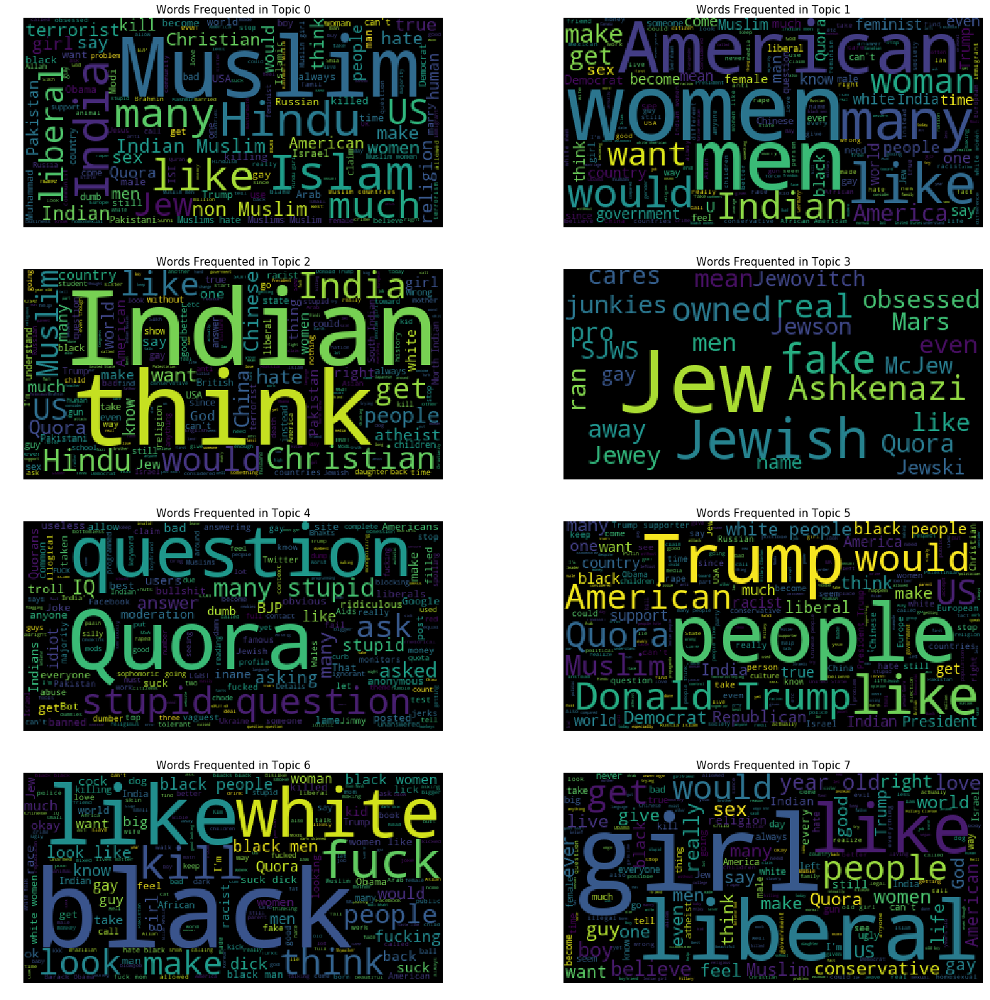

In [36]:
def create_wordcloud(i, data):
#     plt.subplot(int("52{}".format(ax+1)))
    wc =  WordCloud(max_words = 1000, stopwords = stop_words)
    wc.generate(" ".join(data))
    ax[int(i/2)][i%2].axis("off")
    ax[int(i/2)][i%2].set_title("Words Frequented in Topic {}".format(i), fontsize = 15)
    ax[int(i/2)][i%2].imshow(wc)
    
fig, ax = plt.subplots(4, 2, figsize = (25, 25))
for i in range(n_topics):
    text = tsne_lda_df[tsne_lda_df["topics"] == int(i)]["question"]
    create_wordcloud(int(i), text)

***From the word clouds generated above for each we get the following insights:***

***Topic 1:Religious Racism***

Words such as Muslim, Islam, Hindu, Christian, Russian, Religion, India, US, have been repeated more often or are more important. We find a sense of racism here and thus believe that racist comments have been made as a part of insincere questions.

***Topic 2:Gender Bias***

Words such as American, Women, Man, Girl have been repeated more often. Thus we get an insight that "gender bias" related questions have been posted on Quora which qualify as insincere questions.

***Topic 3:Nationalistic Racism***

Words such as Hindu, Muslim, Christian etc have been repeated which again point to racism.

***Topic 4:Anti-sentimentism***

Words such as Fake, Jew, Jewish etc have been repeated more often which are insincere.

***Topic 5:Bullying***

Words such as Stupid, Ask, Many, Questions, Troll Anonymous, Block have been repeated more often. This topic pretty much points out towards the bullying tendency of a human.

***Topic 6:Anti-Trump***

Words such as American, Trump, Donald, Democratic, White, People have been repeated more often which point out to the insincere questions during the elections. People tend to lean on hard towards one party and tend to demean the opposition party.

***Topic 7:Skin color discrimination***

The words in this topic point more towards racism again. An example of this would be the frequent occurrence of words such as Black, White, Kill, Fuck, People, Gay etc.

***Topic 8:Women discrimination***

The repetition of words such as Girl, Sex, Women, Liberal, Like, Men etc more or the less points towards gender bias.

***Above all, we get an insight that the insincere question mainly target Racism, Gender and Politics. Hence it becomes a little easier for us now to detect insincere question.***


# Topic Network

Related paper: Topic Modeling and Network Visualization to Explore Patient Experiences

In [37]:
import networkx as nx
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.spatial.distance import pdist, squareform

cor = squareform(pdist(tsne_lda2, metric = "euclidean"))

In [38]:
cor = squareform(pdist(tsne_lda2[:100], metric = "euclidean"))

In [39]:
labels = {}

for l, i in enumerate(tsne_lda_df2["qid"]):
    labels[l] = i

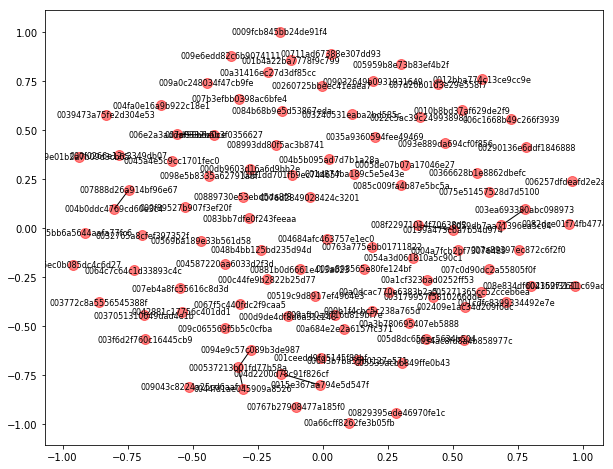

In [40]:
G = nx.Graph()

for i in range(cor.shape[0]):
    for j in range(cor.shape[1]):
        if i == j:
            G.add_edge(i, j, weight = 0)
        else:
            G.add_edge(i, j, weight = 1.0/cor[i, j])
            
G = nx.relabel_nodes(G, labels)
            
edges = [(i, j) for i, j, w in G.edges(data = True) if w["weight"] > 0.8]
edge_weight = dict([((u, v, ), int(d["weight"])) for u, v, d in G.edges(data = True)])

pos = nx.spring_layout(G)

plt.figure(figsize = (10, 8))
nx.draw_networkx_nodes(G, pos, node_size = 100, alpha = 0.5)
nx.draw_networkx_edges(G, pos, edgelist = edges, width = 1)
nx.draw_networkx_labels(G, pos, font_size = 8, font_family = "sans-serif")
plt.show()

## 04. Word frequency analysis

In [41]:
import os
import numpy as np 
import pandas as pd 
import nltk
from nltk.tokenize import word_tokenize, sent_tokenize, TweetTokenizer
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
from collections import Counter
import re
import string
from nltk.util import ngrams
import matplotlib.pyplot as plt

* ### Split all questions in train data into sincere and insincere questions

In [42]:
sincere_df = train[train["target"] == 0]
insincere_df = train[train["target"] == 1]
print("Number of questions labeled with sincere:", len(sincere_df))
print("Number of questions labeled with insincere:",len(insincere_df))

Number of questions labeled with sincere: 1225312
Number of questions labeled with insincere: 80810


* ### Make word count analysis on 10000 sincere and insincere questions respectively

In [43]:
sin_qs = sincere_df['question_text'][:10000] #test with 10000 questions
insin_qs = insincere_df['question_text'][:10000]#test with 10000 questions
clean_sin = sin_qs.apply(clean)
clean_insin = insin_qs.apply(clean)

* ### Three functions that return unigrams, bigrams, trigrams and their counts respectively(most common 20 words or phrases)

In [44]:
def unigrams_freq_20(qs):
    frequencies = Counter([])
    for text in qs:
        token = nltk.word_tokenize(text)
        bigrams = ngrams(token, 1)
        frequencies += Counter(bigrams)
    labels=[]
    values=[]
    for i in frequencies.most_common(20):
        labels.append(i[0])
        values.append(i[1])
    return labels, values

def bigrams_freq_20(qs):
    frequencies = Counter([])
    for text in qs:
        token = nltk.word_tokenize(text)
        bigrams = ngrams(token, 2)
        frequencies += Counter(bigrams)
    labels=[]
    values=[]
    for i in frequencies.most_common(20):
        labels.append(i[0])
        values.append(i[1])
    return labels, values

def trigrams_freq_20(qs):
    frequencies = Counter([])
    for text in qs:
        token = nltk.word_tokenize(text)
        bigrams = ngrams(token, 3)
        frequencies += Counter(bigrams)
    labels=[]
    values=[]
    for i in frequencies.most_common(20):
        labels.append(i[0])
        values.append(i[1])
    return labels, values

## Bar plots

In [45]:
def plot(clean_sin, clean_insin, freqfunc, funcname ):
    sin_labels, sin_values = freqfunc(clean_sin)
    insin_labels, insin_values = freqfunc(clean_insin)
    plt.figure(figsize=(20,5))
    plt.figure(dpi = 100)

    plt.subplot(121)
    sin_y_pos = np.arange(len(sin_labels))
    plt.barh( sin_y_pos, sin_values, align='center', color='blue', alpha=0.4)
    plt.yticks(sin_y_pos,sin_labels,fontsize=8)
    plt.xlabel('frequency')
    plt.title(funcname + "(sincere questions)",fontsize=8)
    plt.gca().invert_yaxis() 

    plt.subplot(122)
    insin_y_pos = np.arange(len(insin_labels))
    plt.barh( insin_y_pos, insin_values, align='center',color='blue',  alpha=0.4)
    plt.yticks(insin_y_pos,insin_labels,fontsize=8)
    plt.xlabel('frequency')
    plt.title(funcname + "(insincere questions)",fontsize=8)
    plt.gca().invert_yaxis() 
    plt.tight_layout()
    plt.show()

<Figure size 1440x360 with 0 Axes>

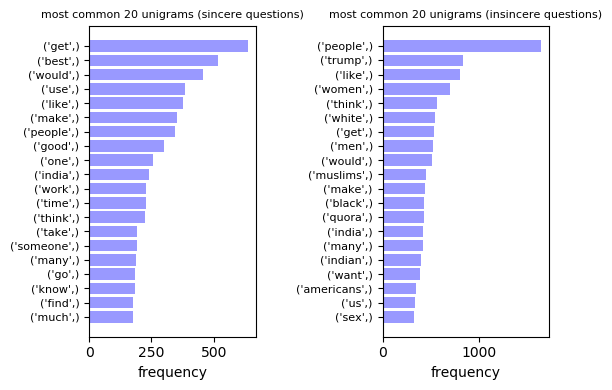

In [46]:
plot(clean_sin, clean_insin,unigrams_freq_20,"most common 20 unigrams ")

* For sincere questions,most of the top 20 unigrams are just common words. Words like 'people' and 'india' show up in both plots 
* For insincere questions, we can make a guess taht they might be about politics issues, gender bias, skin color discrimination, racism, etc. based on the implications of unigrams like 'trump', women', 'men', 'white', 'muslims', 'india', 'indian', 'black', etc.
* Frequency range difference:  The number of questions we plotted with sincere questions and insincere questions are the same(10000 questions). However, the most frequent unigram in sincere questions is around 500, while that in insincere questions is around 1500. This might indicate that lots of insincere questions share similar vocabulary.

<Figure size 1440x360 with 0 Axes>

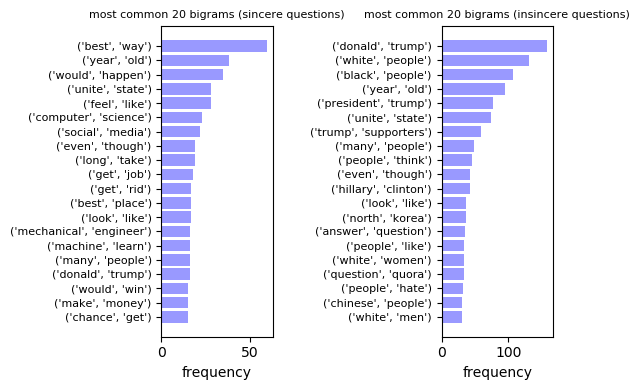

In [47]:
plot(clean_sin, clean_insin,bigrams_freq_20, "most common 20 bigrams ")

* For sincere questions, top bigrams include 'united states', 'computer science', 'social media', machine learning', 'donald trump', etc.
* For insincere questions, top bigrams include 'donald trump', 'president trump', 'trump supporters', 'hilary clinton', 'north korea', 'white people', 'black people', 'white women', 'white men',etc. which reinforced the implications we got from unigrams.
* Frequency range difference:  Same as unigrams

<Figure size 1440x360 with 0 Axes>

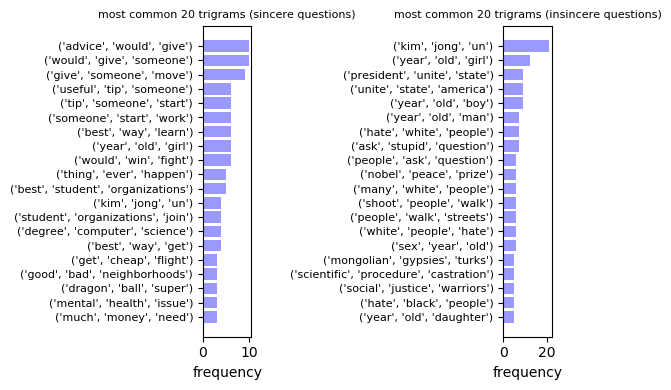

In [48]:
plot(clean_sin, clean_insin,trigrams_freq_20,"most common 20 trigrams ") 

* For sincere questions, top trigrams seem to be related with asking for tips/advice or other meaningful issues like a computer science degree.
* For insincere questions, top trigrams include 'kim jong un', which also shows up in sincere questions' top 20 trigrams, 'presidents united states', 'hate white people', 'hate black people' etc, which again, reinforced the implications we mentioned above.
* Frequency range difference is not very obvious in trigrams due to the small amount of frequencies.

## 05. Sequence Model

In [50]:
import os
import time
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from tqdm import tqdm
import math
from sklearn.model_selection import train_test_split
from sklearn import metrics

from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Dense, Input, LSTM, Embedding, Dropout, Activation, CuDNNGRU, Conv1D
from keras.layers import Bidirectional, GlobalMaxPool1D
from keras.models import Model
from keras import initializers, regularizers, constraints, optimizers, layers

Using TensorFlow backend.


**WORD EMBEDDINGS**

Our dataset is purely user generated text. Knowing this, what better way to make a machine understand this data rather than using word embeddings.

Our fist goal here was to understand a little about word embeddings and the different ways to use them.

Word embeddings, in short, are dence vectors representations of words, mapping semantic meaning into a geometric space.
These vectors can be created by training on massive datasets containing words, sentences, and paragraphs. Examples of popular datasets used for this are Wiki News, Google News, and others. Another option is to not pre-train word embeddings, and just create the embeddings on the data from your project. This will most likely be a comparitively smaller dataset, so probably won't be as comprehensive, but can lead to more specific embeddings. In as plain english as I can put it, word embeddings try to position words in a multidimensional space, resulting in similar words close to eachother and dissimalar words farther away.

Let's set up our data,  and get ready for word embeddings

In [51]:
# read in data
og_train_df = pd.read_csv("train.csv")
test_df = pd.read_csv("test.csv")
print("Train shape : ",og_train_df.shape)
print("Test shape : ",test_df.shape)

Train shape :  (1306122, 3)
Test shape :  (56370, 2)


In [52]:
# split to train and validation
train_df, val_df = train_test_split(og_train_df, test_size=0.1, random_state=2018)

In [53]:
# some config values for word embeddings
embed_size = 300 # how big is each word vector
max_features = 50000 # how many unique words to use (num rows in embedding vector)
maxlen = 100 # max number of words in a question to use

In [54]:
# take care of missing values
train_X = train_df["question_text"].fillna("_na_").values # np array, each index is a question of type string
val_X = val_df["question_text"].fillna("_na_").values
test_X = test_df["question_text"].fillna("_na_").values

In [55]:
# tokenize the sentences, tokenizing prepares text for computers to use
# tokenizer gathers info like:
    # number of documents
    # word counts
    # document counts for each unique word
    # unique index for each word 
tokenizer = Tokenizer(num_words=max_features) # create tokenizer object
tokenizer.fit_on_texts(list(train_X))   # fits to all or our text data 

In [56]:
# represent the questions numerically based on the indexes just assigned be tokenizer
train_X = tokenizer.texts_to_sequences(train_X)
val_X = tokenizer.texts_to_sequences(val_X)
test_X = tokenizer.texts_to_sequences(test_X)

In [57]:
# pad the sentences, the need all be the same length for the algorithms to work
train_X = pad_sequences(train_X, maxlen=maxlen)
val_X = pad_sequences(val_X, maxlen=maxlen)
test_X = pad_sequences(test_X, maxlen=maxlen)

In [58]:
# get np array of the target values
train_y = train_df['target'].values
val_y = val_df['target'].values

**MY TAKE ON SEQUENCE MODELS**

Now our data is all set up to get to learning deeply. Before creating our first model though, let me walk through what I've learned about the models we are about to play with.

Sequence models are the best models to use in a situation like we have here, where there is a natural sequence in the data. Our data is comprised of sentences, wherein information lies in the order of the words. The alternative model type would be the simpler feedforward neural network. Here's an example of how these would differ, at a 30,000 ft abstraction of course.

Let's say we have the odd sentence, "The blue dog rides the yellow cat". Well, this sentence, while already hard to understand, would be impossible to understand if written as more of a bag of words like ["blue", "the", "yellow",  "dog",  "the", "rides",  "cat"]. The purpose of this odd example is to prove that order of words matter for interpretation, which is exactly what a sequence model takes into consideration, and what a feedforward network does not.

**BIDIRECTIONAL GRU (Gated Recurrent Unit) NETWORK**

A bidirectional GRU is a sequence model. This is the model I tried to undersand, and that I played with for this project. 

GRU's, compared to the LSTM models that we also played with in this project, are more computationally efficient because of the reduction of gates, but for the same reason generally perform worse. What are gates? Great question, here's what I got. In a GRU there is an update and a reset gate. The update gate decides on how much of information from the past should be let through. The reset gate decides on how much of information from the past should be discarded. I think of gates as different functions the data has to pass through.

There's another important word in this models name, and that's "bidierectional". Bidirectionality can be applied to any of the sequence models. It makes it to where the model looks at the data not only moving forward sequentially in time, but also backwards. The idea behind this is to pick up context not only from the words behind the current word, but also from words in front of the current word.

Let's give Bidirectional GRU's a shot.

In [59]:
# build the architecture of the model
inp = Input(shape=(maxlen,))
# [first layer] embedding layer from keras, transform words into corresponding word embeddings
x = Embedding(max_features, embed_size)(inp) # remember: max_features=number of unique words, embed_size=number of data points
# [second layer] bidirectional gru, here the bidirectional function is a wrapper that takes a recurrent instance as a parameter
x = Bidirectional(CuDNNGRU(64, return_sequences=True))(x)
# [third layer] global max pool, takes max vector, helps overfitting
x = GlobalMaxPool1D()(x)
# [fourth layer] dense relu function
x = Dense(16, activation="relu")(x)
# [fifth layer] randomly setting a fraction rate of input units to 0, helps with overfitting
x = Dropout(0.1)(x)
# [sixth layer] dense sigmoid function layer giving final probabilities
x = Dense(1, activation="sigmoid")(x)
model = Model(inputs=inp, outputs=x)
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

print(model.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 100)               0         
_________________________________________________________________
embedding_1 (Embedding)      (None, 100, 300)          15000000  
_________________________________________________________________
bidirectional_1 (Bidirection (None, 100, 128)          140544    
_________________________________________________________________
global_max_pooling1d_1 (Glob (None, 128)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 16)                2064      
_________________________________________________________________
dropout_1 (Dropout)          (None, 16)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 17        
Total para

In [ ]:
# train the model, we are only using 2 epochs for the sake of time since we have limited session time caps
model.fit(train_X, train_y, batch_size=512, epochs=2, validation_data=(val_X, val_y))

In [ ]:
# make our predictions from this model
pred_noemb_test_y = model.predict([test_X], batch_size=1024, verbose=1)

# training data predictions for the confusion matric
pred_noemb_train_y = model.predict([train_X], batch_size=1024, verbose=1)

In [ ]:
# clean up a bit
del model, inp, x
import gc; gc.collect()
time.sleep(10)

In [ ]:
# choosing target 0/1 based on the predictions
pred_int = [int(round(x[0])) for x in pred_noemb_train_y]

# confusion matrix
y_actu = pd.Series(train_y, name='Actual')
y_pred = pd.Series(pred_int, name='Predicted')
df_confusion_1 = pd.crosstab(y_actu, y_pred)
df_confusion_1

## 06. Bidirectional LSTM

Using embeddings once again to transform our questions into input features, we built a LSTM (Long Short-Term Memory) network. While the embeddings help with the feature extraction, LSTM support sequence prediction. 

LSTM is a variation of recurrent networks - which means networks that use the feedback loop connected to their past decisions to affect future decisions (they have memory) - that presenve error in a way that allows for a "longer" memory. 

As mentioned above, bidirectional LSTMs involve duplicating the first LTSM layer in the network so that there are now two layers side-by-side, then providing the input sequence as-is as input to the first layer and providing a reversed copy of the input sequence to the second. The use of providing the sequence bi-directionally was initially justified in the domain of speech recognition because there is evidence that the context of the whole utterance is used to interpret what is being said rather than a linear interpretation and in our case it makes sence to use it given that we are trying to identify the context and sentiment related to the questions as a whole.

**PREPARING THE DATA**

First we imported the necessary libraries and split the training data.

In [61]:
# importing all necessary libraries
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

import os
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from tqdm import tqdm
import math
from sklearn.model_selection import train_test_split

In [62]:
# splitting the training data 
train_df = pd.read_csv("train.csv")
train_df, val_df = train_test_split(train_df, test_size=0.1)

![](http://)Using the selected embedding model, which for each word produces a 300 dimension vector, we created a dictionary of all the words and their respective vectors. It needs to be noted that the list of words also includes characters that are used in sentences and add context (e.g. ".", ",", etc.). As a result, the implementation of the embeddings takes into account all characters (words and symbols) of the sentences so that when the replacement is taking place the amount of context is not reduced or lost.

In [64]:
# setting up a dictionary of words and relevant embeddings (300-dimension vectors)
embeddings_index = {}
f = open('./embeddings/glove.840B.300d/glove.840B.300d.txt', encoding="utf-8")

for line in tqdm(f):
    values = line.split(" ")
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()

print('Found %s word vectors.' % len(embeddings_index))

2196017it [03:54, 9383.29it/s] 

Found 2196016 word vectors.


We create a function that breaks down a given question into a list of embeddings and implement the same for the first 3000 questions for the purposes of this kernel, while also a function that splits questions to batches of 128.

In [65]:
# Converting a question to an array of embeddings
def text_to_array(text):
    empyt_emb = np.zeros(300)
    text = text[:-1].split()[:238]   # we disregard the last character of the sentence which is always a questionmark
                                     # and use 238 which is the word size of the largest question
    embeds = [embeddings_index.get(x, empyt_emb) for x in text]
    embeds+= [empyt_emb] * (238 - len(embeds)) 
    return np.array(embeds)

# train_vects = [text_to_array(X_text) for X_text in tqdm(train_df["question_text"])]
val_vects = np.array([text_to_array(X_text) for X_text in tqdm(val_df["question_text"][:3000])])
val_y = np.array(val_df["target"][:3000])

100%|██████████| 3000/3000 [00:04<00:00, 646.78it/s]


In [66]:
# create batches of 128 questions breaking them down into an array of words and their relevant target
batch_size = 128

def batch_gen(train_df):
    n_batches = math.ceil(len(train_df) / batch_size)
    while True: 
        train_df = train_df.sample(frac=1.)  # Shuffle the data.
        for i in range(n_batches):
            texts = train_df.iloc[i*batch_size:(i+1)*batch_size, 1]
            text_arr = np.array([text_to_array(text) for text in texts])
            yield text_arr, np.array(train_df["target"][i*batch_size:(i+1)*batch_size])

**TRAINING THE MODEL**

In [67]:
from keras.models import Sequential
from keras.layers import CuDNNLSTM, Dense, Bidirectional

In [68]:
# we create a sequential model which is a linear stack of the two LSTM models
model = Sequential()
# CuDNNLSTM is an LSTM implementation backed by CuDNN and runs only on GPU, with the TensorFlow backend
# CuDNN is NVIDIA’s library for deep neural nets built using CUDA (NVIDIA’s language/API for programming on the graphics card)
model.add(Bidirectional(CuDNNLSTM(64, return_sequences=True), input_shape=(238,300)))
model.add(Bidirectional(CuDNNLSTM(64)))
# adding non-linear layer: sigmoid function
model.add(Dense(1, activation="sigmoid"))

# setting up the loss function calculation
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [ ]:
# train the model
# again we are only using 2 epochs for the sake of time since we have limited session time caps
mg = batch_gen(train_df)
model.fit_generator(mg, epochs=2,
                    steps_per_epoch=1000,
                    validation_data=(val_vects, val_y),
                    verbose=True)

In [ ]:
# prediction part
batch_size = 256 
def batch_gen(test_df):
    n_batches = math.ceil(len(test_df) / batch_size)
    for i in range(n_batches):
#         val_vects = np.array([text_to_array(X_text) for X_text in tqdm(test_df["question_text"])])
#         print(len(val_vects))
#         text_arr = val_vects[i*batch_size:(i+1)*batch_size, 1]
        texts = test_df.iloc[i*batch_size:(i+1)*batch_size, 1]
        text_arr = np.array([text_to_array(text) for text in texts])
        yield text_arr

test_df = pd.read_csv("test.csv")

In [ ]:
# making predictions
all_preds = []
for x in tqdm(batch_gen(test_df)):
    all_preds.extend(model.predict(x).flatten())

In [ ]:
train_preds = []
og_train_df = pd.read_csv("../input/train.csv")
for x in tqdm(batch_gen(og_train_df)):
    train_preds.extend(model.predict(x).flatten())
    
# choosing target 0/1 based on the predictions
lstm_pred_train = (np.array(train_preds) > 0.5).astype(np.int)

# confusion matrix
y_actu_lstm = pd.Series(train_y, name='Actual')
y_pred_lstm = pd.Series(lstm_pred_train, name='Predicted')
df_confusion_2 = pd.crosstab(y_actu_lstm, y_pred_lstm)
df_confusion_2

In [ ]:
# choosing target 0/1 based on the predictions
y_te = (np.array(all_preds) > 0.5).astype(np.int)

submit_df = pd.DataFrame({"qid": test_df["qid"], "prediction": y_te})

## 07. References

The below references were taken into consideration for the creation of the above kernel: 

1. https://www.kaggle.com/konohayui/topic-modeling-on-quora-insincere-questions
2. https://www.kaggle.com/mihaskalic/lstm-is-all-you-need-well-maybe-embeddings-also
3. https://towardsdatascience.com/introduction-to-sequence-models-rnn-bidirectional-rnn-lstm-gru-73927ec9df15
4. https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/
5. https://blog.keras.io/using-pre-trained-word-embeddings-in-a-keras-model.html
6. https://machinelearningmastery.com/cnn-long-short-term-memory-networks/
7. http://faculty.washington.edu/atchen/pubs/Chen_Sheble_Eichler_VAHC2013.pdf
8. https://www.kaggle.com/konohayui/topic-modeling-on-quora-insincere-questions